### 1. Capturing images from a mono camera
chụp ảnh và tạo ra 1 bộ gồm nhiều ảnh bàn cờ ở các góc độ khác nhau ---> cơ sở để hiệu chỉnh camera

In [9]:
import numpy as np
import cv2
import time
import os

cam = cv2.VideoCapture(0)

i = 0

while(True):
    success, frame = cam.read()
    
    if (success == False):
        print("Cannot read frame")
        
        break
        
    key = cv2.waitKey(20) & 0xFF
    
    if (key == ord('q')):
        break
    
    elif (key == 32): #space
        cv2.imwrite("calib2025/" + str(i) + ".jpg", frame)
        i += 1
    
    cv2.imshow("frame", frame)

cam.release()
cv2.destroyAllWindows()
cv2.waitKey(10)

-1

### Recording video from a mono camera

In [ ]:
import numpy as np
import cv2
import time

cam = cv2.VideoCapture(0)

assert success

success, frame = cam.read()
w, h, _ = frame.shape

out = cv2.VideoWriter("outpy" + str(time.time()) + ".avi",
                      cv2.VideoWriter_fourcc('M','J','P','G'), 30, (h, w))

record = False

while(True):
    success, frame = cam.read()
    
    if (success == False):
        print("Cannot read frame")
        
        break
    
    if (record == True):
        out.write(frame)
        
        cv2.circle(frame, (50, 50), 20, (0, 0, 250), -1)
    
    key = cv2.waitKey(20) & 0xFF

    if (key == ord('w')):
        record = not record
    
    if (key == ord('q')):
        break
    
    elif (key == 32): #space
        cv2.imwrite("calib2025/" + str(i) + ".jpg", frame)
        i += 1
    
    cv2.imshow("frame", frame)

out.release()
cam.release()
cv2.destroyAllWindows()
cv2.waitKey(10)

In [1]:
!ls calib_fira2024

'ls' is not recognized as an internal or external command,
operable program or batch file.


### Finding corners of a chessboard
Tìm các góc trên bàn cờ trong mỗi ảnh.--> cơ sở để hiệu chỉnh camera

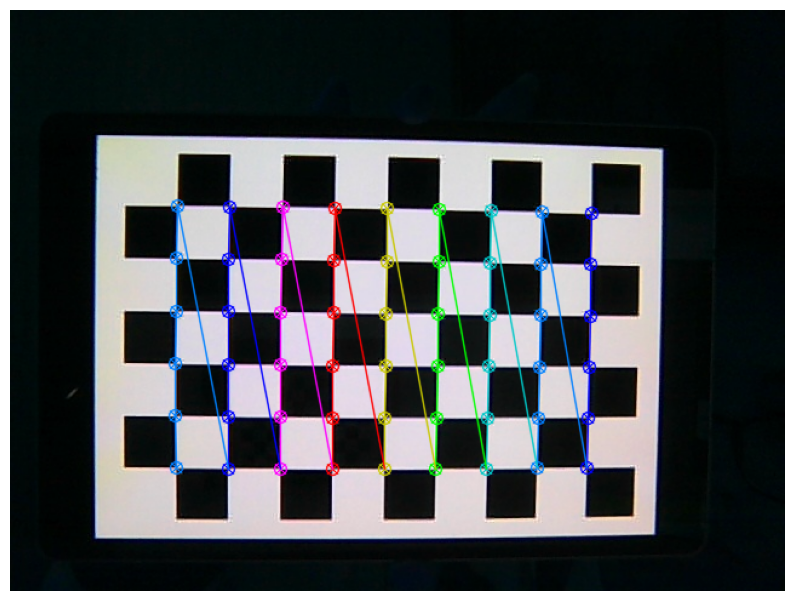

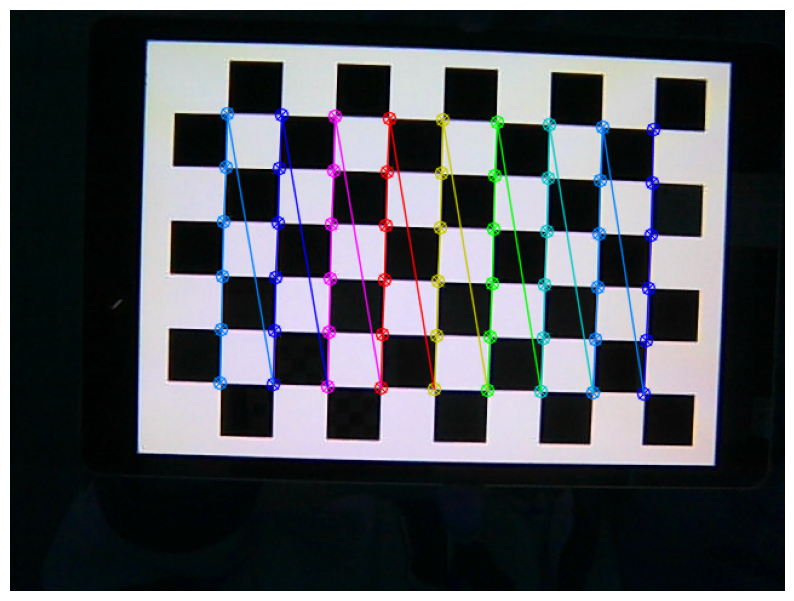

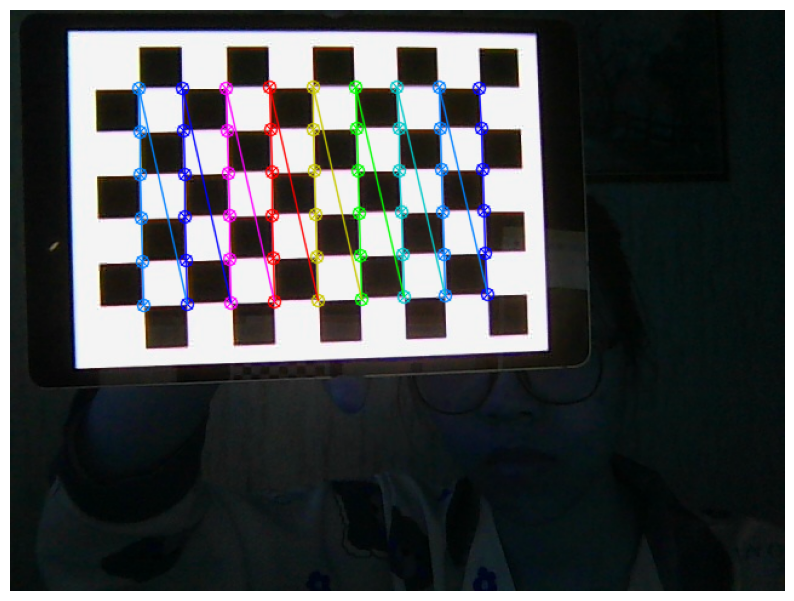

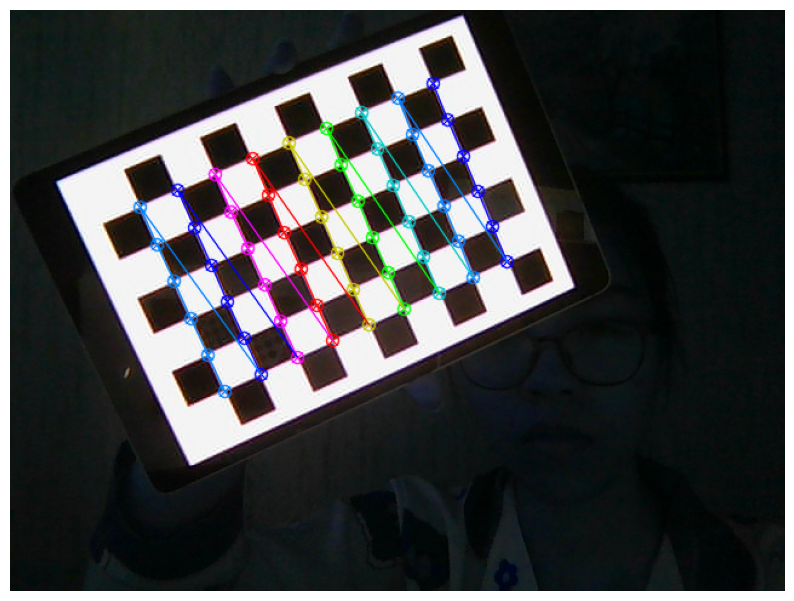

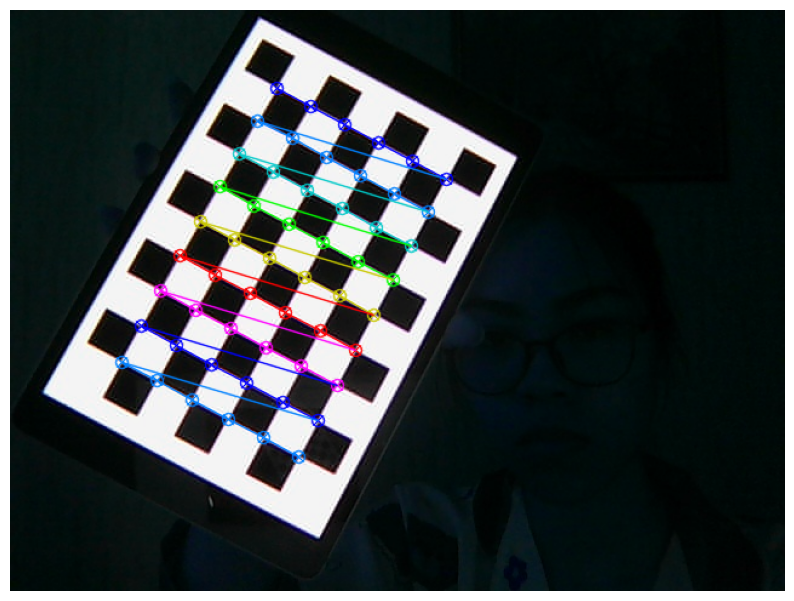

...

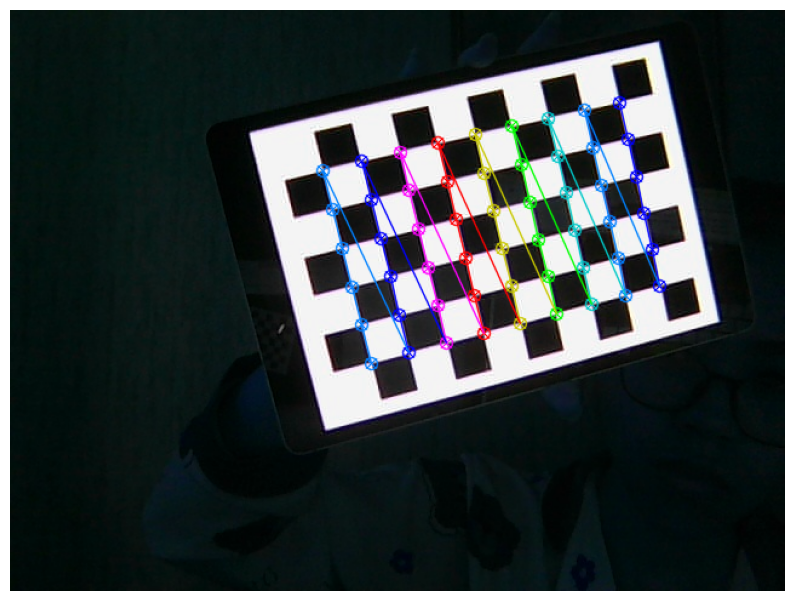

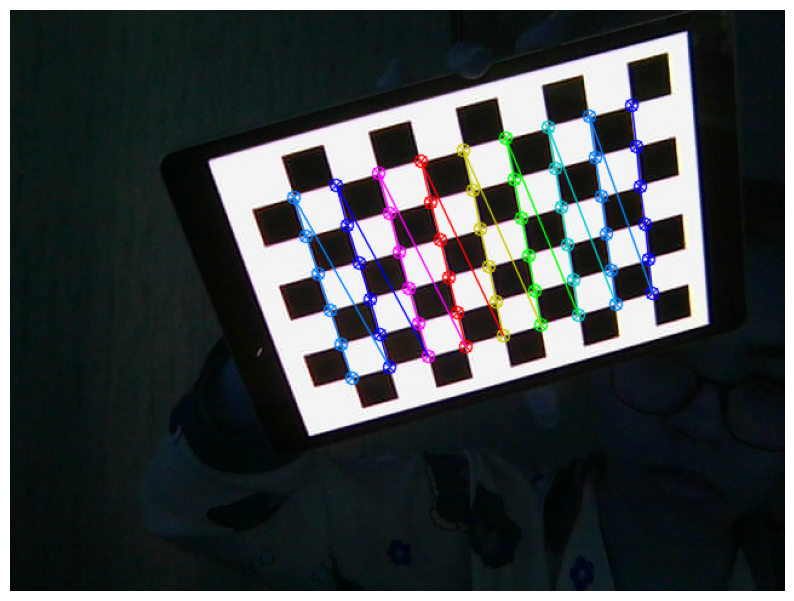

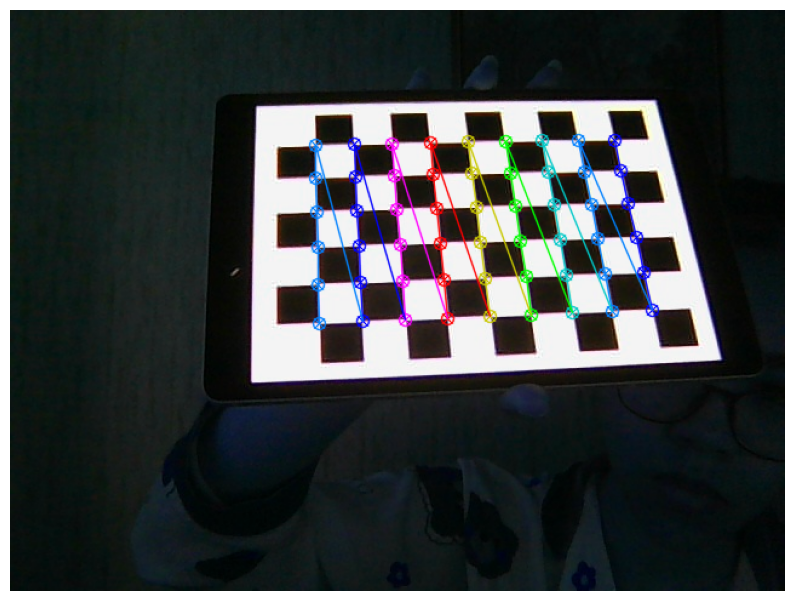

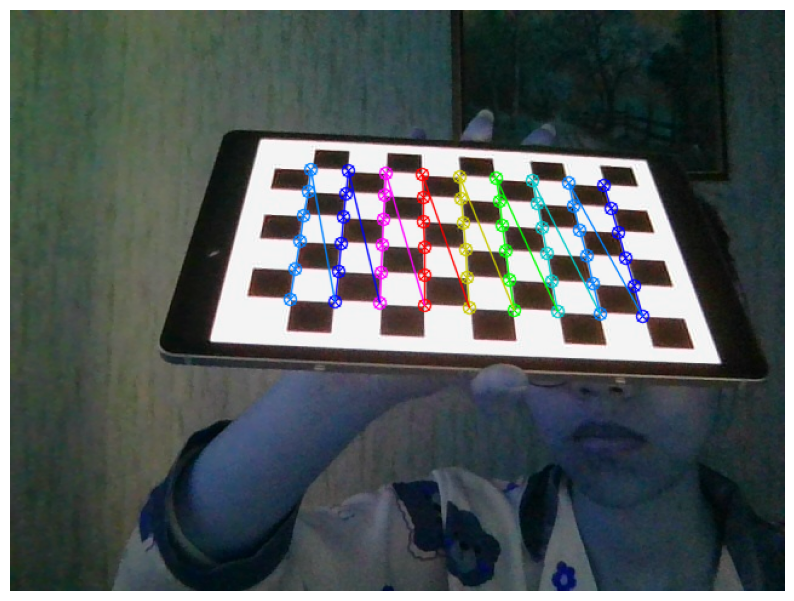

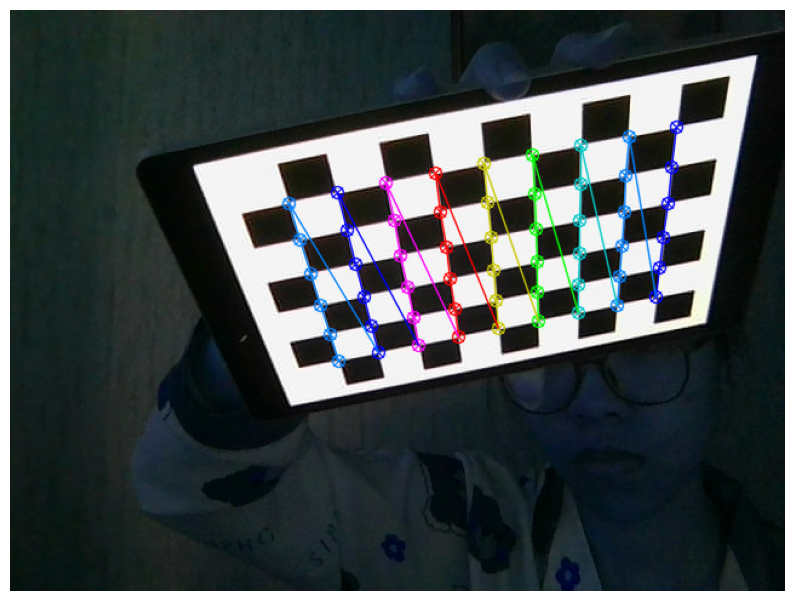

In [16]:
import numpy as np
import cv2
import glob  #Dùng để tìm kiếm tất cả các tệp ảnh trong thư mục.
from matplotlib import pyplot as plt
plt.rcParams["figure.figsize"] = (10,10) #Cấu hình kích thước của hình ảnh khi hiển thị bằng matplotlib.

# termination criteria
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((9*6,3), np.float32)  # Creating an Array for 3D real-world coordinates of chessboard corners
objp[:,:2] = np.mgrid[0:6,0:9].T.reshape(-1,2) * 0.019   #A list of 2D image coordinates of the detected chessboard corners.

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d point in real world space
imgpoints = [] # 2d points in image plane.

images = glob.glob('calib2025/*.jpg')
#images = glob.glob('calib_fira2024/*.jpg')

for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chess board corners
    
    ret, corners = cv2.findChessboardCorners(gray, (6, 9),None)
    #for fisheye

    # If found, add object points, image points (after refining them)
    if ret == True:
        objpoints.append(objp)

        corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
        imgpoints.append(corners2)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (6, 9), corners2,ret)
        
        plt.imshow (img)
        plt.axis ('off')
        plt.show ()
        #cv2.imshow('img',img)
        
        cv2.waitKey(50)

cv2.destroyAllWindows()

### 2. Camera calibration 
Hiệu chỉnh camera là quá trình xác định các thông số nội suy (A) và méo (dist) để loại bỏ sự biến dạng trong ảnh.

OpenCV cung cấp hàm cv2.calibrateCamera() để tính các giá trị này.

--> Mỗi camera có một tập hợp A và dist duy nhất dựa trên thiết kế quang học của nó.

Tuy nhiên, các giá trị này có thể thay đổi nếu camera có tiêu cự thay đổi (zoom) hoặc bị thay đổi vị trí vật lý (ví dụ: lắp lại ống kính).

In [17]:
import cv2

ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints,
                gray.shape[::-1],None,None)#, flags=cv2.CALIB_TILTED_MODEL)

print("ret", ret)

print("\nmtx", mtx)

print("\ndist", dist)

print("\nrvecs")

for i in range(7):
    print(rvecs[i])
    print("")

print("\ntvecs")

for i in range(7):
 
    print(tvecs[i])
    print("")

ret 0.09891137698155295

mtx [[653.79017244   0.         325.45730598]
 [  0.         654.02497422 240.77670025]
 [  0.           0.           1.        ]]

dist [[-0.19878638  0.50415653  0.00260482  0.00095636 -0.52617064]]

rvecs
[[-0.03800836]
 [-0.0699597 ]
 [ 1.58275254]]

[[ 0.00814614]
 [-0.05337834]
 [ 1.59964299]]

[[-0.10533287]
 [-0.09725564]
 [ 1.53698096]]

[[-0.05013919]
 [-0.18747987]
 [ 1.14981256]]

[[-0.10417489]
 [-0.08288549]
 [ 0.48844659]]

[[-0.03165099]
 [-0.83457597]
 [-0.11241098]]

[[ 0.01761731]
 [-0.12191424]
 [ 1.28783285]]


tvecs
[[ 0.06957263]
 [-0.03266393]
 [ 0.2915749 ]]

[[ 0.0894983 ]
 [-0.06172558]
 [ 0.27835933]]

[[ 0.03430581]
 [-0.09786513]
 [ 0.35759753]]

[[ 0.01372466]
 [-0.10632788]
 [ 0.38199961]]

[[-0.06289944]
 [-0.10515998]
 [ 0.38356184]]

[[-0.09876134]
 [-0.07699806]
 [ 0.39508482]]

[[-0.01202843]
 [-0.10118532]
 [ 0.4079595 ]]



### Distance to a chessboard pattern
Mục đích chính của đoạn code này là xác định vị trí của bàn cờ trong không gian 3D bằng cách sử dụng phép chiếu PnP (Perspective-n-Point).

solvePnP ước lượng vị trí (tvec) và góc quay (rvec) của bàn cờ so với camera.


In [ ]:
import numpy as np
import cv2
import glob
from matplotlib import pyplot as plt
import math
# A = np.array([[1.43375330e+03, 0.00000000e+00, 9.59754528e+02],
#               [0.00000000e+00, 1.42562382e+03, 5.92222278e+02],
#               [0.00000000e+00, 0.00000000e+00, 1.00000000e+00]])

# dist = np.array([[-0.38840459,  0.15585353, -0.00261017, -0.00065496, -0.02653892]])

A = np.array([[653.79017244, 0.00000000, 325.45730598],
              [0.00000000, 654.02497422, 240.77670025],
              [0.00000000, 0.00000000, 1.00000000]])

dist = np.array([[-0.19878638,  0.50415653,  0.00260482,  0.00095636,  -0.52617064]])

chx, chy = 5, 8  # size of chessboard

objp = np.zeros((chy*chx,3), np.float32)
objp[:,:2] = np.mgrid[0:chy,0:chx].T.reshape(-1,2) * 0.03

objpoints = [] # 3d point in real world space
imgpoints = [] # 2d points in image plane.

filename = 0#"outpy1694191193.58813.avi"

cam = cv2.VideoCapture(0)#filename)

while(True):
    success, frame = cam.read()
    
    if (success == False):
        #print("Cannot read frame. Exiting")
        #break
        
        cam.release()
        cam = cv2.VideoCapture(filename)
        continue

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    ret, corners = cv2.findChessboardCorners(gray, (chx, chy), None)

    if (ret == True):
        #solvePnP ước lượng vị trí (tvec) và góc quay (rvec) của bàn cờ so với camera.
        s, rvec, tvec = cv2.solvePnP(objp, corners, A, dist, flags=0)

        if (s == False):
            continue
        
        #print(rvec)

        #Hiển thị kết quả lên màn hình
        srvec = "rvec: " + str(rvec[0][0])[:5] + " " + str(rvec[1][0])[:5] + " " + str(rvec[2][0])[:5]
        image = cv2.putText(frame, srvec, (50, 50), cv2.FONT_HERSHEY_SIMPLEX, 
                           1.5, (255, 255, 0), 2, cv2.LINE_AA)

        stvec = "tvec: " + str(tvec[0][0])[:5] + " " + str(tvec[1][0])[:5] + " " + str(tvec[2][0])[:5]
        image = cv2.putText(frame, stvec, (50, 100), cv2.FONT_HERSHEY_SIMPLEX, 
                           1.5, (255, 255, 0), 2, cv2.LINE_AA)
        
        #thanks to https://answers.opencv.org/question/217179/angle-between-wall-and-camera-using-pnpransac-and-its-precision/
        #Chuyển góc quay từ ma trận xoay sang góc Euler
        Rt = cv2.Rodrigues(rvec)
        Rt = np.transpose(Rt[0])
        sy = math.sqrt(Rt[0, 0] * Rt[0, 0] + Rt[1, 0] * Rt[1, 0])
        singular = sy < 1e-6 # kiểm tra trường hợp đặc biết tránh lỗi tính toán

        # rotation matrix to Euler Angles Tính góc quay Euler (x, y, z) từ ma trận xoay.
        if not singular:
            x = math.atan2(Rt[2,1] , Rt[2,2] )* (180 / np.pi)
            y = math.atan2(-Rt[2,0], sy) * (180 / np.pi)
            z = math.atan2(Rt[1,0], Rt[0,0]) * (180 / np.pi)

        else:
            x = math.atan2(-Rt[1,2], Rt[1,1]) * (180 / np.pi)
            y = math.atan2(-Rt[2,0], sy)* (180 / np.pi)
            z = 0

        #Hiển thị góc quay (Euler Angles) trên màn hình.
        image = cv2.putText(frame, str(x)[:5] + " " +
                                   str(y)[:5] + " " +
                                   str(z)[:5], (50, 150), cv2.FONT_HERSHEY_SIMPLEX, 
                           1.5, (255, 255, 0), 2, cv2.LINE_AA)

    cv2.imshow("frame", frame)

    key = cv2.waitKey(70) & 0xFF
        
    if (key == ord('q')):
        break

cam.release()
cv2.destroyAllWindows()
cv2.waitKey(10)

#     # If found, add object points, image points (after refining them)
#     if ret == True:
#         objpoints.append(objp)

#         corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
#         imgpoints.append(corners2)

#         # Draw and display the corners
#         img = cv2.drawChessboardCorners(img, (7, 9), corners2,ret)
        
#         plt.imshow (img)
#         plt.axis ('off')
#         plt.show ()
#         #cv2.imshow('img',img)
        
#         cv2.waitKey(50)

### Distance to an object of known size

Xác định một vật thể có màu sắc cụ thể trong khung hình.

Xác định chiều cao (h) của vật thể đó trong ảnh.

Dựa vào chiều cao thực tế (h0) của vật thể ngoài đời và một khoảng cách tham chiếu (d0), ước lượng khoảng cách thực tế đến vật thể theo công thức:

distance= d0×h0/h

In [1]:
import numpy as np
import cv2

cam = cv2.VideoCapture(0)

d0 = 0.38 # cm
h0 = 0.16

while(True):
    success, frame = cam.read()
    
    if (success == False):
        print("Cannot read frame. Exiting")
        break
    
    blurred = cv2.blur(frame, (7, 7))
    hsv = cv2.cvtColor(blurred, cv2.COLOR_BGR2HSV)
    
    mask = cv2.inRange(hsv, (34, 57, 220), (228, 171, 255))
    
    cv2.imshow("mask", mask)
    
    connectivity = 4
    output = cv2.connectedComponentsWithStats(mask, connectivity, cv2.CV_32S)
    
    num_labels = output[0]
    labels = output[1]
    stats = output[2]
    
    obj_h = 0.0000000001
    
    for i in range(1, num_labels):
        a = stats[i, cv2.CC_STAT_AREA]
        t = stats[i, cv2.CC_STAT_TOP]
        l = stats[i, cv2.CC_STAT_LEFT]
        w = stats[i, cv2.CC_STAT_WIDTH]
        h = stats[i, cv2.CC_STAT_HEIGHT]
        
        if (a >= 4500):
            cv2.rectangle(frame, (l, t), (l + w, t + h), (212, 123, 234), 4)
            
            obj_h = h
            
            print(h)
            
            break
    
    distance = d0 * h0 / obj_h
    
    image = cv2.putText(frame, str(distance)[:5], (50, 50), cv2.FONT_HERSHEY_SIMPLEX, 
                           0.8, (255, 255, 0), 1, cv2.LINE_AA)
    
    cv2.imshow("frame", frame)

    key = cv2.waitKey(30) & 0xFF
        
    if (key == ord('q')):
        break

cam.release()
cv2.destroyAllWindows()
cv2.waitKey(10)

95
100
102
95
96
96
98
97
97
95
96
105
122
139
154
178
202
281
273
270
273
273
261
255
263
251
255
258
258
257
251
251
235
251
250
252
254
258
263
278
262
262
263
263
263
264
265
269
270
271
272
272
271
271
272
273
271
273
274
275
276
278
282
283
285
286
249
254
253
252
247
246
245
247
247
247
247
247
247
247
248
245
245
244
241
244
243
243
245
244
246
244
245
247
247
249
250
247
248
244
249
245
244
245
245
247
249
247
244
224
229
223
243
235
242
243
243
243
245
245
246
243
245
245
247
248
247
246
251
256
309
308
316
311
309
261
255
251
247
249
241
226
226
228
233
238
253
263
287
208
189
61
66
75
79
78
77
265
284
277
260
238
215
203
170
168
163
160
158
155
155
152
150
140
139
139
134
135
137
134
174
174
175
169
174
178
181
182
181
180
179
176
175
176
178
127
127
130
111
112
113
127
129
129
133
131
131
131
118
119
118
115
152
190
184
179
139
152
179
188
168
168
169
168
182
180
142
142
147
158
156
161
139
139
151
155
163
168
184
185
186
186
186
175
241
241
242
244
247
247
247
247
249
249

-1

### pic2r

Phát hiện vật thể có màu trong phạm vi xác định (màu xanh lam).

Xác định vị trí (x, y) của vật thể trong ảnh.

Chuyển đổi tọa độ ảnh sang tọa độ trong không gian thực tế bằng cách sử dụng ma trận nội suy (A), góc nghiêng (beta), và chiều cao của camera (h).

Hiển thị tọa độ thực tế trên ảnh.

In [18]:
import numpy as np
import math
import cv2

# A - matrix of intrinsic parameters
# a - angle of rotation of the camera around vertical axis
# b - inclination angle of the camera
# x, y - coordinates of the object in the picture
# h - height of the camera above the ground
'''
fx, fy: Tiêu cự trên các trục.
(cx, cy): Tọa độ trung tâm ảnh.
(Xc, Yc): Tọa độ ảnh chuẩn 
Zr = h / tan(beta): Tính khoảng cách từ camera đến mặt phẳng chứa vật thể.
Xr, Yr: Tọa độ thực tế của vật thể.
'''

def pic2r(A, alpha, beta, x, y, h):
    fx = A[0, 0]
    fy = A[1, 1]
    cx = A[0, 2]
    cy = A[1, 2]
    
    Xc = (x - cx) / fx
    Yc = (y - cy) / fy
    
    Zr = h / math.tan(beta)
    
    Xr = Zr * Xc
    Yr = Zr * Yc
    
    return Xr, Yr

A = np.array([[653.79017244, 0.00000000, 325.45730598],
              [0.00000000, 654.02497422, 240.77670025],
              [0.00000000, 0.00000000, 1.00000000]])

dist = np.array([[-0.19878638,  0.50415653,  0.00260482,  0.00095636,  -0.52617064]])

#print(pic2r(A, 0.3, 0.45, 10, 30, 10))

cam = cv2.VideoCapture(0)

x, y = 0, 0

while(True):
    success, frame = cam.read()
    
    if (success == False):
        print("Cannot read frame. Exiting")
        break
    
    blurred = cv2.blur(frame, (7, 7))
    hsv = cv2.cvtColor(blurred, cv2.COLOR_BGR2HSV)
    
    mask = cv2.inRange(hsv, (99, 185, 98), (138, 253, 255))
    
    cv2.imshow("mask", mask)
    
    connectivity = 4
    output = cv2.connectedComponentsWithStats(mask, connectivity, cv2.CV_32S)
    
    num_labels = output[0]
    labels = output[1]
    stats = output[2]
    
    filtered = np.zeros_like(mask)
    
    obj_h = 0
    
    for i in range(1, num_labels):
        a = stats[i, cv2.CC_STAT_AREA]
        t = stats[i, cv2.CC_STAT_TOP]
        l = stats[i, cv2.CC_STAT_LEFT]
        w = stats[i, cv2.CC_STAT_WIDTH]
        h = stats[i, cv2.CC_STAT_HEIGHT]

        if (a >= 4500):
            cv2.rectangle(frame, (l, t), (l + w, t + h), (123, 223, 134), 3)
            
            x = l + w // 2
            y = t + h
            
            break
    
    xr, yr = pic2r(A, 0, (90 - 54) / 180 * math.pi, x, y, 30)
    
    image = cv2.putText(frame, str(xr)[:5] + " " + str(yr)[:5], (50, 50), cv2.FONT_HERSHEY_SIMPLEX, 
                           1.5, (255, 255, 0), 1, cv2.LINE_AA)
    
    cv2.imshow("frame", frame)

    key = cv2.waitKey(90) & 0xFF
        
    if (key == ord('q')):
        break

cam.release()
cv2.destroyAllWindows()
cv2.waitKey(10)

-1